In [1]:
from google.colab import drive
drive.mount('/gdrive')
%cd /gdrive/My Drive/notebooks

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /gdrive
/gdrive/My Drive/notebooks


# Configs

In [0]:
import torch
import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

import matplotlib.pyplot as plt
import numpy as np 
import random
import math

import os

In [3]:
DATA_PATH = os.path.dirname('/content/')
modelName = "ACGAN-CIFAR10"
log_PATH = os.path.join(os.getcwd(), "logs","acgan")

batch_size = 100
workers = 2

epochs = 100

latent_dim=100
class_dim= 10

gf_dim = 96
df_dim = 16

in_w = in_h = 32
c_dim = 3

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

manualSeed = 3734
print("Random Seed: ",manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  3734


# Data loading

In [0]:
import torch
import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

import numpy as np
import os

transform = transforms.Compose(
    [
     transforms.Resize((in_h,in_w)),
     transforms.ToTensor(),
     transforms.Normalize((0.5,),(0.5,)),
     ]
)

def transform_inverse (y):
  t= None
  if y.size()[0]==1:
    t=torchvision.transforms.Normalize((-1,),(2,))
  else :
    t=torchvision.transforms.Normalize((-1,-1,-1),(2,2,2))
  return t(y)

def batch_transform_inverse(y):
  x = y.new(*y.size())
  if y.size()[1]==1:
    x[:, 0, :, :] = y[:, 0, :, :] * 2 - 1
  else:
    x[:, 0, :, :] = y[:, 0, :, :] * 2 - 1
    x[:, 1, :, :] = y[:, 1, :, :] * 2 - 1 
    x[:, 2, :, :] = y[:, 2, :, :] * 2 - 1
  return x

In [5]:
train_set = torchvision.datasets.CIFAR10(root=DATA_PATH,train=True,
                                      download=True,transform=transform)
train_loader = torch.utils.data.DataLoader(train_set,batch_size=batch_size,
                                          shuffle =True, num_workers=workers)

test_set = torchvision.datasets.CIFAR10 (root=DATA_PATH,train=False,
                                     download=True, transform=transform)

test_loader = torch.utils.data.DataLoader(test_set, batch_size=batch_size,
                                          shuffle = False, num_workers=workers)

train_iter = iter(train_loader)
test_iter = iter(test_loader)


Extracting /content/cifar-10-python.tar.gz to /content
Files already downloaded and verified


torch.Size([100, 3, 32, 32])


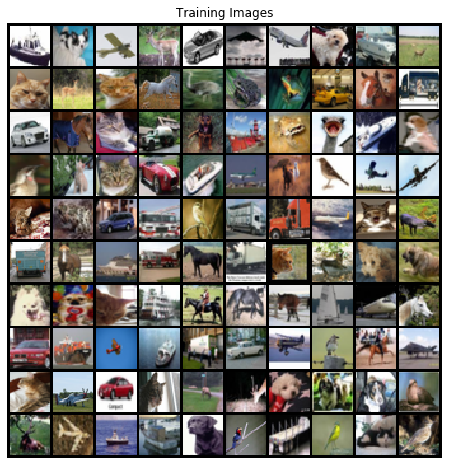

In [6]:
import matplotlib.pyplot as plt

real_batch, _ = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device),nrow=10,padding=2, normalize=True).cpu(),(1,2,0)))

print(real_batch.size())

#ops

In [0]:
def conv_bn_layer(in_channels,out_channels,kernel_size,stride=1,padding=0):
    return nn.Sequential(
        nn.Conv2d(in_channels,out_channels,kernel_size,stride=stride,padding=padding),
        nn.BatchNorm2d(out_channels,momentum=0.1,eps=1e-5),
    )
def tconv_bn_layer(in_channels,out_channels,kernel_size,stride=1,padding=0,output_padding=0):
  return nn.Sequential(
      nn.ConvTranspose2d(in_channels,out_channels,kernel_size,stride=stride,padding=padding,output_padding=output_padding),
      nn.BatchNorm2d(out_channels,momentum=0.1,eps=1e-5),
  )
def tconv_layer(in_channels,out_channels,kernel_size,stride=1,padding=0,output_padding=0):
  return nn.ConvTranspose2d(in_channels,out_channels,kernel_size,stride=stride,padding=padding,output_padding=output_padding)

def conv_layer(in_channels,out_channels,kernel_size,stride=1,padding=0):
    return nn.Conv2d(in_channels,out_channels,kernel_size,stride=stride,padding=padding)

def fc_layer(in_features,out_features):
  return nn.Linear(in_features,out_features)

def fc_bn_layer(in_features,out_features):
  return nn.Sequential(
      nn.Linear(in_features,out_features),
      nn.BatchNorm1d(out_features)
  )


In [8]:
def conv_out_size_same(size, stride):
  return int(math.ceil(float(size) / float(stride)))
s_h, s_w = in_h, in_w
s_h2, s_w2 = conv_out_size_same(s_h, 2), conv_out_size_same(s_w, 2)
s_h4, s_w4 = conv_out_size_same(s_h2, 2), conv_out_size_same(s_w2, 2)
s_h8, s_w8 = conv_out_size_same(s_h4, 2), conv_out_size_same(s_w4, 2)

print(s_h8, s_w8)

4 4


# Models

In [0]:
import torch.nn as nn
import torch.nn.functional as F

class Generator(nn.Module):
  def __init__(self):
    super(Generator,self).__init__()
    self.fc_layer1 = fc_layer(latent_dim+class_dim,gf_dim*8)
    self.up_sample_layer2 = tconv_bn_layer(gf_dim*8,gf_dim*4,4,2,0)
    self.up_sample_layer3 = tconv_bn_layer(gf_dim*4,gf_dim*2,4,2,1)
    self.up_sample_layer4 = tconv_bn_layer(gf_dim*2,gf_dim,4,2,1)
    self.up_sample_layer5 = tconv_layer(gf_dim,c_dim,4,2,1)
    self.tanh = nn.Tanh()

  def forward(self, x):
    x = F.relu(self.fc_layer1(x)).view(-1,gf_dim*8,1,1)
    x = F.relu(self.up_sample_layer2(x))
    x = F.relu(self.up_sample_layer3(x))
    x = F.relu(self.up_sample_layer4(x))
    x = self.up_sample_layer5(x)
    return self.tanh(x)

In [0]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator,self).__init__()
    self.conv_layer1 = conv_layer(c_dim,df_dim,3,2,1)
    self.conv_layer2 = conv_bn_layer(df_dim,df_dim*2,3,1,1)
    self.conv_layer3 = conv_bn_layer(df_dim*2,df_dim*4,3,2,1)
    self.conv_layer4 = conv_bn_layer(df_dim*4,df_dim*8,3,1,1)
    self.conv_layer5 = conv_bn_layer(df_dim*8,df_dim*16,3,2,1)
    self.conv_layer6 = conv_bn_layer(df_dim*16,df_dim*32,3,1,1)
    self.aux_fc_layer7 = fc_layer(df_dim*32*s_w8*s_h8,class_dim) # cls
    self.dis_fc_layer7 = fc_layer(df_dim*32*s_w8*s_h8,1) # fake/real
    self.sigmoid = nn.Sigmoid()
    self.softmax = nn.Softmax(dim=-1)

  def forward(self, x):
    x = F.leaky_relu(self.conv_layer1(x),0.2)
    x = F.leaky_relu(self.conv_layer2(x),0.2)
    x = F.leaky_relu(self.conv_layer3(x),0.2)
    x = F.leaky_relu(self.conv_layer4(x),0.2)
    x = F.leaky_relu(self.conv_layer5(x),0.2)
    x = F.leaky_relu(self.conv_layer6(x),0.2)
    x = x.view(-1,df_dim*32*s_w8*s_h8)
    aux = self.aux_fc_layer7(x)
    disc = self.dis_fc_layer7(x)

    return self.softmax(aux), self.sigmoid(disc)

In [0]:
def weights_init(m):
  classname =m.__class__.__name__
  if classname.find('Conv')!=-1 or classname.find('Linear')!=-1: # for Conv,Linear
    nn.init.normal_(m.weight.data,0.0,0.02)
    nn.init.constant_(m.bias.data,0)
  elif classname.find('BatchNorm')!=-1:# Reference : https://discuss.pytorch.org/t/weight-initialization-for-batchnorm-in-dcgan-tutorial/32351
    nn.init.normal_(m.weight.data,1.0,0.02)
    nn.init.constant_(m.bias.data,0)

#Train config

In [12]:
import torch.optim as optim
import torch.nn as nn

G = Generator().to(device)
D = Discriminator().to(device)

bce_criterion = nn.BCELoss()
nll_criterion = nn.NLLLoss()

G_optimizer = optim.Adam(G.parameters(), lr=5e-4,betas=(0.5,0.999))#lr = [1e-4, 2e-4, 3-e4]
D_optimizer = optim.Adam(D.parameters(), lr=2e-4,betas=(0.5,0.999))#lr = [1e-4, 2e-4, 3-e4]

fixed_latent = torch.randn(100,latent_dim,device=device)
fixed_labels = torch.zeros(100,class_dim,device=device)
for j in range(10):
  for i in range(class_dim):
    fixed_labels[i*10+j][i]=1

fixed_noise=torch.cat((fixed_latent,fixed_labels),1)

print(D.apply(weights_init))
print(G.apply(weights_init))

Discriminator(
  (conv_layer1): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv_layer2): Sequential(
    (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer3): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer4): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer5): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer6): Sequential(
    (0): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    

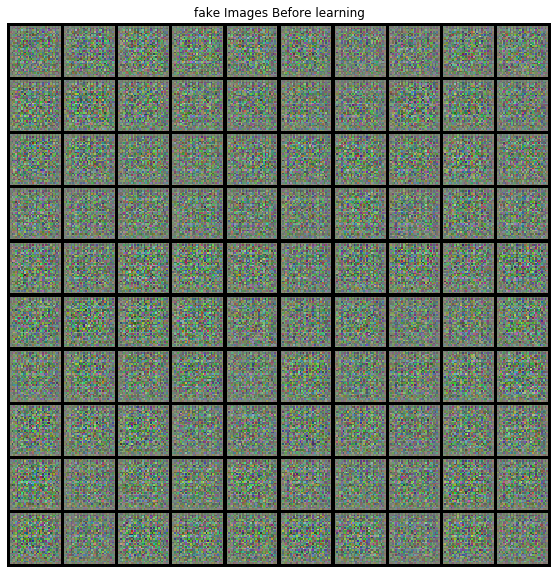

In [13]:
with torch.no_grad():
  fake_batch=G(fixed_noise)
plt.figure(figsize=(10,10))
plt.axis('off')
plt.title('fake Images Before learning')
plt.imshow(np.transpose(vutils.make_grid(fake_batch.to(device).view(100,c_dim,in_h,in_w),nrow=10,padding=2, normalize=True).cpu(),(1,2,0)))

In [0]:
def compute_cls_acc(m_disc,cls_labels):
  return ((m_disc.argmax(dim=1) == cls_labels)*1.0).sum()/100

img_list = []
G_losses = []
D_losses = []

iter_per_plot = 100
plot_per_eps=(int(len(train_loader)/iter_per_plot))
transform_PIL=transforms.ToPILImage()

D_Ls_losses=[]
D_Lc_losses=[]
G_Ls_losses=[]
G_Lc_losses=[]

real_dis_list=[]
fake_dis_list=[]
real_cls_list=[]
fake_cls_list=[]

# Train

In [15]:
for ep  in range(epochs):
  for i, (data, cls_labels) in enumerate(train_loader):
    b_size=data.shape[0]

    data = data.to(device)
    cls_labels = cls_labels.to(device)

    cls_one_hot=torch.zeros(b_size,class_dim,device=device)
    cls_one_hot[torch.arange(b_size), cls_labels] = 1.0

    real_labels = torch.ones(b_size,1).to(device)
    fake_labels = torch.zeros(b_size,1).to(device)

    #with real
    # Train D
    D.zero_grad()
    _ , real_score = m_disc, b_disc = D(data)
    bce_real_loss = bce_criterion(b_disc,real_labels)
    cls_real_loss = nll_criterion(m_disc,cls_labels)

    real_cls_acc=compute_cls_acc(m_disc,cls_labels)#for logging

    #with fake

    latent_z = torch.randn(b_size,latent_dim).to(device)
    latent_c = cls_one_hot
    latent = torch.cat((latent_z,latent_c),dim=1)

    fake = G(latent)
    _, fake_score = m_disc, b_disc = D(fake.detach())
    bce_fake_loss = bce_criterion(b_disc,fake_labels)
    cls_fake_loss = nll_criterion(m_disc,cls_labels)

    fake_cls_acc=compute_cls_acc(m_disc,cls_labels)#for logging


    D_Ls = bce_real_loss + bce_fake_loss
    D_Lc = 1.8*cls_real_loss + 0.2*cls_fake_loss # for learning stability
    loss_D = D_Ls + D_Lc

    loss_D.backward()

    D_optimizer.step()

    #Train G
    G.zero_grad()

    m_disc, b_disc = D(fake)
    G_Ls = bce_criterion(b_disc,real_labels)
    G_Lc = nll_criterion(m_disc,cls_labels)
    loss_G = G_Ls + G_Lc# 이거 fake_label로 바꾸고 -로 바꾸니 안됐음 원인 확인필요...
    loss_G.backward()
    G_optimizer.step()
    
    
    if (i+1)%iter_per_plot == 0 :
      print('Epoch [{}/{}], Step [{}/{}], d_loss: {:.4f}, g_loss: {:.4f}, D_Ls:{:.4f}, D_Lc:{:.4f}, D(real): {:.2f}, D(fake): {:.2f},real_cls_acc:{:.2f},fake_cls_acc:{:.2f} ' 
            .format(ep, epochs, i+1, len(train_loader), loss_D.item(), loss_G.item(),D_Ls.item(),D_Lc.item(), real_score.mean(), fake_score.mean(),real_cls_acc,fake_cls_acc))
      G_losses.append(loss_G.item())
      D_losses.append(loss_D.item())
      D_Ls_losses.append(D_Ls.item())
      D_Lc_losses.append(D_Lc.item())
      G_Ls_losses.append(G_Ls.item())
      G_Lc_losses.append(G_Lc.item())
      real_dis_list.append(real_score.mean())
      fake_dis_list.append(fake_score.mean())
      real_cls_list.append(real_cls_acc)
      fake_cls_list.append(fake_cls_acc)


      if (i+1)%(iter_per_plot*2) ==0:
        with torch.no_grad():
          fake = G(fixed_noise).detach().cpu()
          img_list.append(vutils.make_grid(torch.reshape(fake,(100,c_dim,in_h,in_w)),nrow=10, padding=2, normalize=True))
          transform_PIL(img_list[-1]).save(os.path.join(log_PATH,modelName+'- '+str(ep)+".png"))


Epoch [0/100], Step [100/500], d_loss: 0.4380, g_loss: 3.0031, D_Ls:1.0022, D_Lc:-0.5641, D(real): 0.70, D(fake): 0.31,real_cls_acc:0.32,fake_cls_acc:0.09 
Epoch [0/100], Step [200/500], d_loss: 0.6138, g_loss: 6.6967, D_Ls:1.2172, D_Lc:-0.6034, D(real): 0.82, D(fake): 0.50,real_cls_acc:0.35,fake_cls_acc:0.11 
Epoch [0/100], Step [300/500], d_loss: 0.0440, g_loss: 2.2892, D_Ls:0.5048, D_Lc:-0.4608, D(real): 0.73, D(fake): 0.06,real_cls_acc:0.24,fake_cls_acc:0.08 
Epoch [0/100], Step [400/500], d_loss: 0.1817, g_loss: 5.5641, D_Ls:0.8345, D_Lc:-0.6528, D(real): 0.82, D(fake): 0.39,real_cls_acc:0.33,fake_cls_acc:0.10 
Epoch [0/100], Step [500/500], d_loss: -0.4258, g_loss: 3.5151, D_Ls:0.2410, D_Lc:-0.6668, D(real): 0.95, D(fake): 0.15,real_cls_acc:0.41,fake_cls_acc:0.09 
Epoch [1/100], Step [100/500], d_loss: 0.2422, g_loss: 4.2374, D_Ls:0.7741, D_Lc:-0.5319, D(real): 0.87, D(fake): 0.33,real_cls_acc:0.30,fake_cls_acc:0.10 
Epoch [1/100], Step [200/500], d_loss: 0.3493, g_loss: 6.7943, 

# Evaluation

Animation size has reached 21330702 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


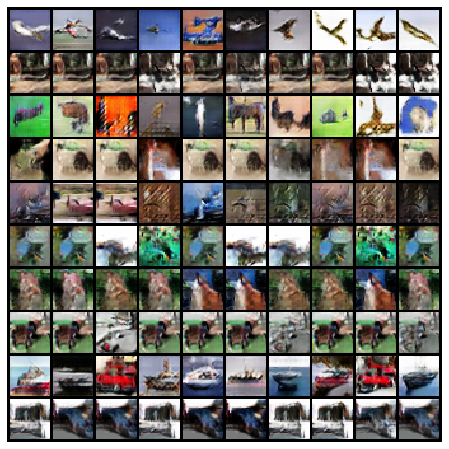

In [16]:
import matplotlib.animation as animation
from IPython.display import HTML
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

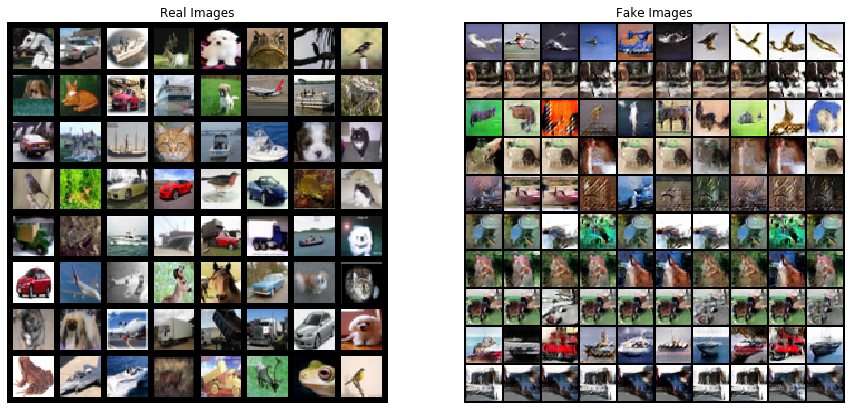

In [17]:
real_batch = next(iter(train_loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))

In [0]:
from PIL import Image
transform_PIL=transforms.ToPILImage()

p_img_list = [transform_PIL(p_image) for p_image in img_list]
p_img_list[0].save(modelName+'.gif', save_all=True,append_images=p_img_list[1:], optimize=False, duration=10, loop=0)
p_img_list[-1].save(modelName+"_last_result.png")

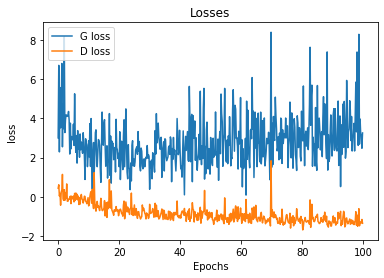

In [28]:
plt.title("Losses")
epsilon = 1/plot_per_eps
X = np.array(range(plot_per_eps*epochs))/plot_per_eps

plt.plot(X,G_losses,label="G loss")
plt.plot(X,D_losses,label="D loss")
plt.legend(loc=2)
plt.xticks(np.arange(0,epochs+1,20)) 
plt.ylabel("loss")
plt.xlabel("Epochs")
plt.savefig(modelName+"_loss_figure.png")

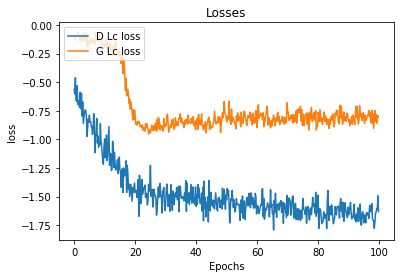

In [34]:
plt.title("Losses")
epsilon = 1/plot_per_eps
X = np.array(range(plot_per_eps*epochs))/plot_per_eps


plt.plot(X,D_Lc_losses,label="D Lc loss")
plt.plot(X,G_Lc_losses,label="G Lc loss")
plt.legend(loc=2)
plt.xticks(np.arange(0,epochs+1,20)) 
plt.ylabel("loss")
plt.xlabel("Epochs")
#plt.show()
plt.savefig(modelName+"_loss_lc_figure.png")

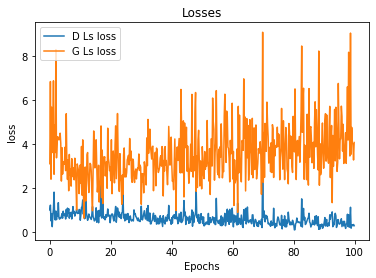

In [35]:
plt.title("Losses")
epsilon = 1/plot_per_eps
X = np.array(range(plot_per_eps*epochs))/plot_per_eps


plt.plot(X,D_Ls_losses,label="D Ls loss")
plt.plot(X,G_Ls_losses,label="G Ls loss")
plt.legend(loc=2)
plt.xticks(np.arange(0,epochs+1,20)) 
plt.ylabel("loss")
plt.xlabel("Epochs")
#plt.show()
plt.savefig(modelName+"_loss_ls_figure.png")

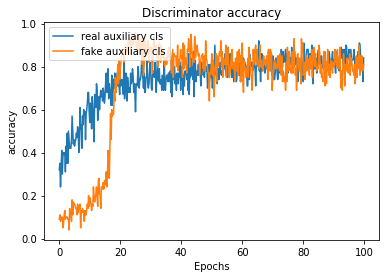

In [38]:
plt.title("Discriminator accuracy")
epsilon = 1/plot_per_eps
X = np.array(range(plot_per_eps*epochs))/plot_per_eps

plt.plot(X,real_cls_list,label="real auxiliary cls")
plt.plot(X,fake_cls_list,label="fake auxiliary cls")

plt.legend(loc=2)
plt.xticks(np.arange(0,epochs+1,20)) 
plt.ylabel("accuracy")
plt.xlabel("Epochs")
#plt.show()
plt.savefig(modelName+"_disc_acc_figure.png")

# Model save

In [40]:
torch.save(D.state_dict(),"./D_"+modelName+".pth")
D.load_state_dict(torch.load("D_"+modelName+".pth"))

<All keys matched successfully>

In [41]:
torch.save(G.state_dict(),"./G_"+modelName+".pth")
G.load_state_dict(torch.load("G_"+modelName+".pth"))

<All keys matched successfully>